In [2]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from torch import nn


In [3]:
print(torch.__version__)
print(torch.cuda.is_available())
device = torch.device("cuda")

2.4.0
True


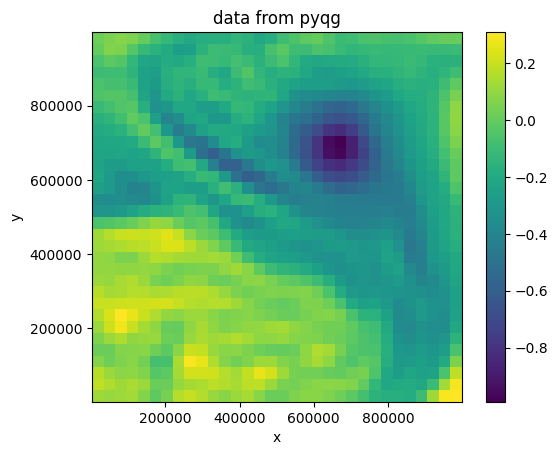

In [ ]:
# Загрузка данных
x = np.load('x_eddy_noforce_q.npy')
y = np.load('y_eddy_noforce_q.npy')
#data = np.load('data_eddy_noforce_q.npy')
data = np.load('data_pyqg_noise0.005.npy')

# Визуализация данных
plt.title('data from pyqg')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(data, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()


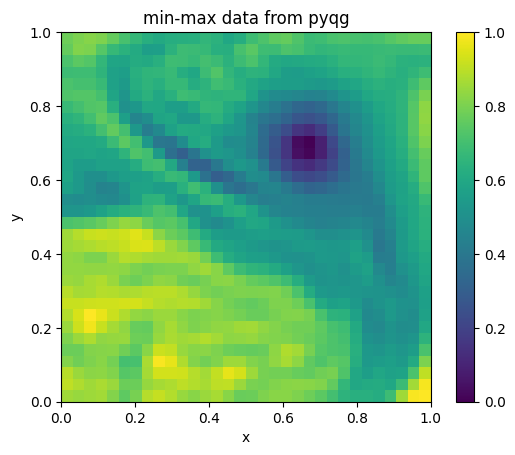

In [ ]:
# Масштабирование сетки от 0 до 1
x = (x - np.min(x)) / (np.max(x) - np.min(x))

y = (y - np.min(y)) / (np.max(y) - np.min(y))

#масштабирование данных до 0 до 1
data = (data - np.min(data)) / (np.max(data) - np.min(data))


# Визуализация данных
plt.title('min-max data from pyqg')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(data, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()

[[0.55839615 0.60928072 0.63414428 ... 0.5106772  0.5343486  0.53612585]
 [0.52548535 0.62496398 0.60334414 ... 0.35364801 0.35381055 0.3671529 ]
 [0.43065453 0.49809042 0.46536127 ... 0.27793644 0.27129085 0.2854044 ]
 ...
 [0.78260899 0.70287715 0.65026762 ... 0.1584394  0.4306364  0.80912254]
 [0.80708791 0.76344534 0.71161866 ... 0.36215859 0.72634801 0.97008002]
 [0.71194684 0.688991   0.7065031  ... 0.71434206 0.98210694 1.        ]]


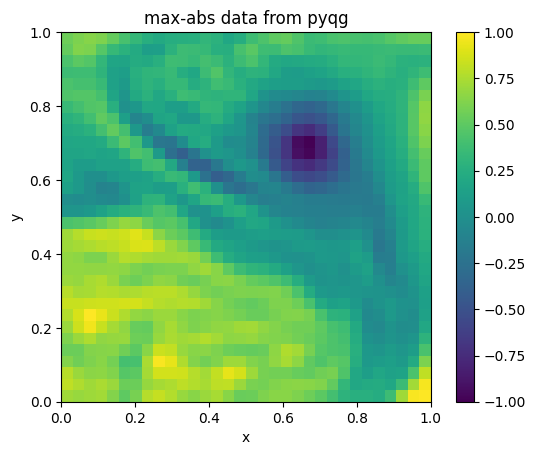

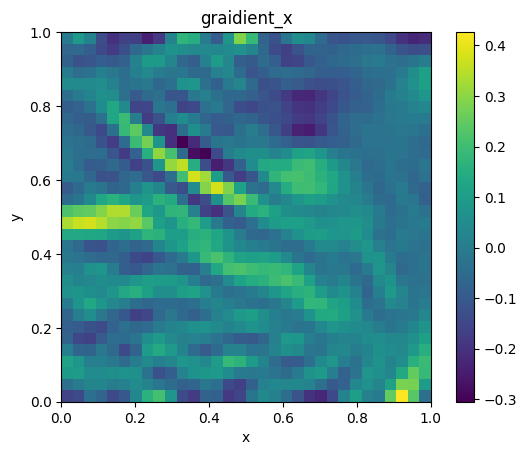

In [21]:
#масштабирование данных до -1 до 1
data = 2 * (data - np.min(data)) / (np.max(data) - np.min(data)) - 1
print(data)

gradient_x = np.gradient(data,axis = 0, edge_order=2)
gradient_y = np.gradient(data,axis = 1, edge_order=2)
gradient_xx = np.gradient(gradient_x,axis = 0, edge_order=2)
gradient_yy = np.gradient(gradient_y,axis = 1, edge_order=2)

# Визуализация данных
plt.title('max-abs data from pyqg')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(data, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()

plt.title('graidient_x')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(gradient_x, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()

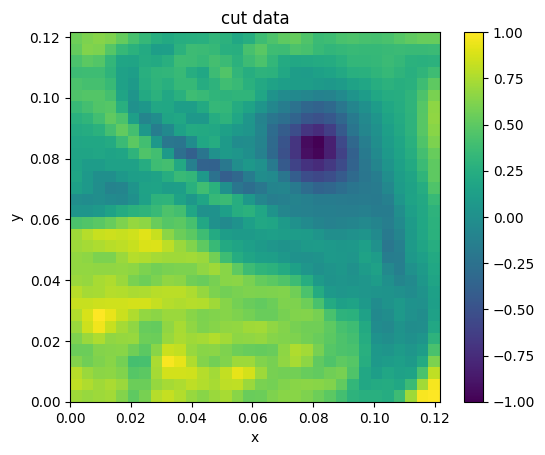

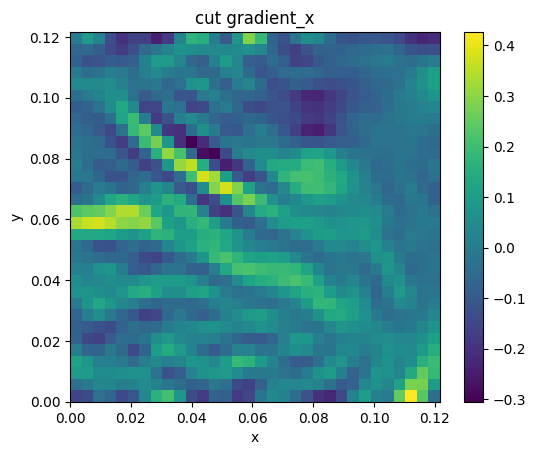

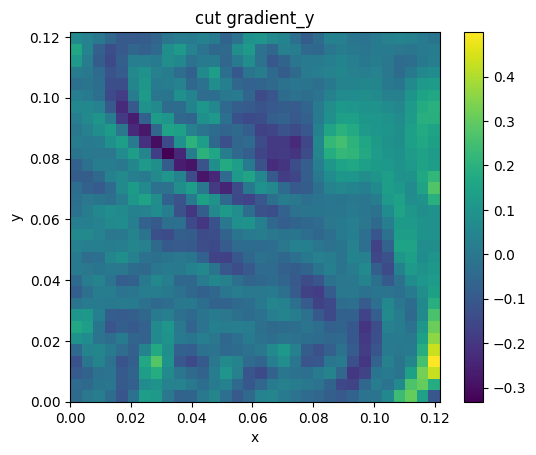

In [22]:
x = x[0:32]
y = y[0:32]
data = data[0:32,0:32]
gradient_x = gradient_x[0:32,0:32]
gradient_y = gradient_y[0:32,0:32]
gradient_xx = gradient_xx[0:32,0:32]
gradient_yy = gradient_yy[0:32,0:32]

plt.title('cut data')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(data, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()

plt.title('cut gradient_x')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(gradient_x, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()

plt.title('cut gradient_y')
plt.xlabel('x')
plt.ylabel('y')
plt.imshow(gradient_y, extent=[np.min(x), np.max(x), np.min(y), np.max(y)])
plt.colorbar()
plt.show()

In [23]:
print(data.shape)
print(y.shape)

(32, 32)
(32,)


In [24]:
data = torch.from_numpy(data)
x = torch.from_numpy(x)
y = torch.from_numpy(y)
gradient_x = torch.from_numpy(gradient_x)
gradient_y = torch.from_numpy(gradient_y)
gradient_xx = torch.from_numpy(gradient_xx)
gradient_yy = torch.from_numpy(gradient_yy)

In [25]:
#device = torch.device("cpu")
#device = torch.device("cuda")

x = x.float().to(device)
y = y.float().to(device)
data = data.float().to(device)
gradient_x = gradient_x.to(dtype=torch.float32).to(device)
gradient_y = gradient_y.to(dtype=torch.float32).to(device)
gradient_xx = gradient_xx.to(dtype=torch.float32).to(device)
gradient_yy = gradient_yy.to(dtype=torch.float32).to(device)

In [26]:
data = np.load('pyqg_Inverse_x_noise0.005.npy')
data = torch.from_numpy(data)
data = data.float().to(device)

In [27]:
#обучение на одном интеграле с early stopping на loss и на градиенты и с динамическим lr(лучше по t, те ouput1)
import torch.optim as optim

# Определение модели
model = torch.nn.Sequential(
    torch.nn.Linear(2, 1024),
    torch.nn.ReLU(),
    torch.nn.Linear(1024, 512),
    torch.nn.ReLU(),
    torch.nn.Linear(512, 256),
    torch.nn.ReLU(),
    torch.nn.Linear(256, 128),
    torch.nn.ReLU(),
    torch.nn.Linear(128, 64),
    torch.nn.ReLU(),
    torch.nn.Linear(64, 32),
    torch.nn.ReLU(),
    torch.nn.Linear(32, 16),
    torch.nn.ReLU(),
    torch.nn.Linear(16, 8),
    torch.nn.ReLU(),
    torch.nn.Linear(8, 2)
).to(device)

criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2000, factor=0.7)

grid_points = torch.stack(torch.meshgrid(y, x, indexing='ij'), dim=-1).reshape(-1, 2).to(device)

def integrate_gradients(dx, dy, initial_value):
    
    integral_y= torch.zeros_like(dx)
    integral_y[0] = initial_value  
    for i in range(1, dy.shape[0]):
        integral_y[:, i] = integral_y[:, i - 1] + ((dy[:, i] + dy[:, i - 1])) / 2  
    
    integral_x = torch.zeros_like(dy)
    integral_x[0] = integral_y[0] 
    
    for j in range(1, dx.shape[1]):
        integral_x[j] = integral_x[j - 1] + ((dx[j] + dx[j - 1])) / 2  

    return integral_x

losses = []
initial_value = data[0, 0]
best_loss = float('inf')#хранит наименьшее значение потерь, достигнутое моделью. Изначально оно установлено в бесконечность
patience_counter = 0#отслеживает количество эпох с ухудшением потерь.
patience_limit = 10000  #задает максимальное количество эпох без улучшения, после которого обучение будет остановлено.
target_accuracy = 0.0005  # желаемая точность

for epoch in range(500000):
    optimizer.zero_grad()
    output = model(grid_points).reshape(32, 32, 2).to(device)
    output1 = output[:,:,0]
    output2 = output[:,:,1]
    integral = integrate_gradients(output1, output2, initial_value).to(device)
    loss = criterion(integral, data)                                                   
    loss.backward()                                                                   
    optimizer.step()                                                                  
    # Динамическое изменение learning rate
    scheduler.step(loss)#позволяет планировщику изменять learning rate на основе текущих потерь. Если потери не улучшаются в течение заданного количества эпох (patience), learning rate уменьшается на указанный фактор.
    losses.append(loss.item())                                                        
    print(f'Epoch {epoch}, Loss: {loss.item()}')
    '''
    # Проверка на достижение целевой точности
    accuracy_x = torch.mean(torch.square(gradient_x - output1))
    accuracy_y = torch.mean(torch.square(gradient_y - output2))
    accuracy = (torch.mean(torch.square(gradient_x - output1)) + torch.mean(torch.square(gradient_y - output2))) / 2
    print('mse_gradients_x = ', accuracy_x)
    print('mse_gradients_y = ', accuracy_y)
    print('mse_gradients = ', accuracy)

    if accuracy_x < target_accuracy:
        print(f'Целевая точность достигнута на эпохе {epoch}. Остановка обучения.')
        break
    '''

    # Ранняя остановка
    if loss.item() < best_loss:#Если текущие потери меньше, чем best_loss, то обновляем best_loss и сбрасываем patience_counter.
        best_loss = loss.item()
        patience_counter = 0
        # Сохранение модели (если нужно)
        # torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1#Если текущие потери не улучшаются, увеличиваем patience_counter.
        
        if patience_counter >= patience_limit:#Если patience_counter достигает patience_limit, выводим сообщение о срабатывании ранней остановки и прерываем цикл обучения.
            print("Early stopping triggered.")
            break

print(output1.shape)
print(output2.shape)




Epoch 0, Loss: 12.1566801071167
Epoch 1, Loss: 11.127212524414062
Epoch 2, Loss: 10.049610137939453
Epoch 3, Loss: 9.117046356201172
Epoch 4, Loss: 7.977091312408447
Epoch 5, Loss: 6.779547214508057
Epoch 6, Loss: 5.242389678955078
Epoch 7, Loss: 3.360621452331543
Epoch 8, Loss: 1.4045766592025757
Epoch 9, Loss: 0.08119933307170868
Epoch 10, Loss: 1.031639575958252
Epoch 11, Loss: 2.138411045074463
Epoch 12, Loss: 1.8014237880706787
Epoch 13, Loss: 0.9352344274520874
Epoch 14, Loss: 0.27654939889907837
Epoch 15, Loss: 0.04123644903302193
Epoch 16, Loss: 0.1581364870071411
Epoch 17, Loss: 0.38945722579956055
Epoch 18, Loss: 0.5767110586166382
Epoch 19, Loss: 0.6641467809677124
Epoch 20, Loss: 0.6472973823547363
Epoch 21, Loss: 0.5428289175033569
Epoch 22, Loss: 0.3810925781726837
Epoch 23, Loss: 0.21140837669372559
Epoch 24, Loss: 0.09915100038051605
Epoch 25, Loss: 0.03487984091043472
Epoch 26, Loss: 0.027710234746336937
Epoch 27, Loss: 0.07499884068965912
Epoch 28, Loss: 0.14732636511

0.09247935


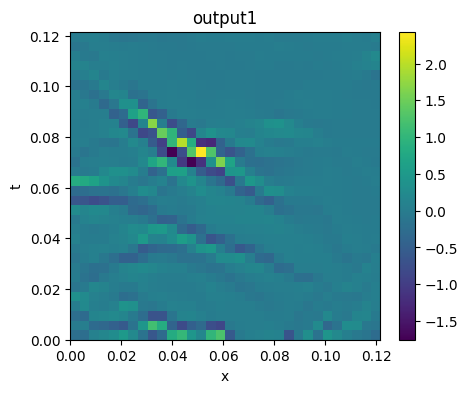

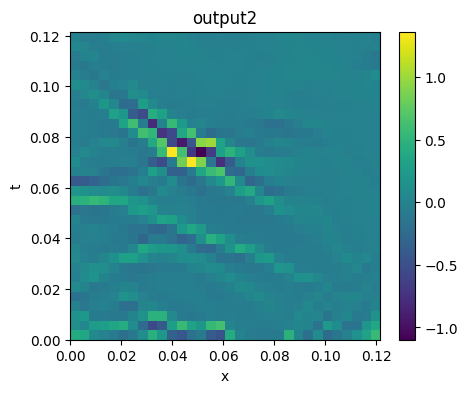

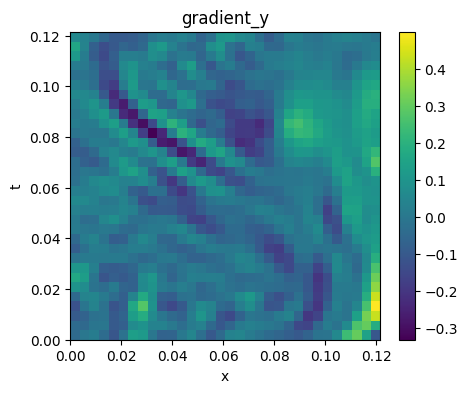

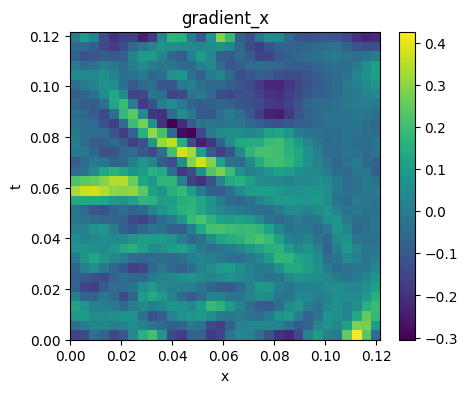

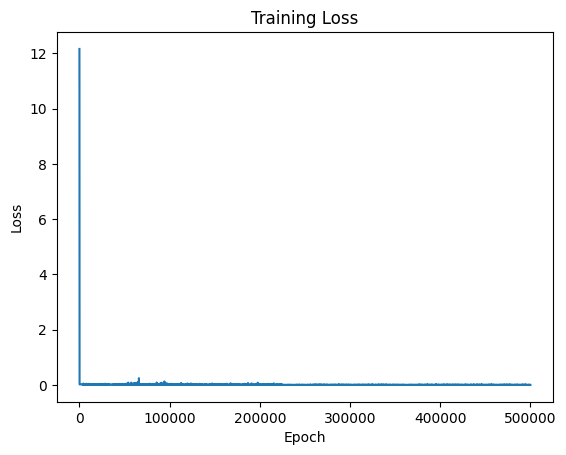

In [28]:
output1 = output1.detach().cpu().numpy() 
output2 = output2.detach().cpu().numpy()
x =  x.detach().cpu().numpy() 
y =  y.detach().cpu().numpy() 
data = data.detach().cpu().numpy() 
gradient_x = gradient_x.detach().cpu().numpy() 
gradient_y = gradient_y.detach().cpu().numpy() 

print((np.square(output1 - gradient_x)).mean(axis=None))

plt.figure(figsize=(5, 4))
plt.imshow(output1, aspect='auto',extent=[np.min(x), np.max(x), np.min(y), np.max(y)], cmap='viridis')
plt.title('output1')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(output2, aspect='auto',extent=[np.min(x), np.max(x), np.min(y), np.max(y)], cmap='viridis')
plt.title('output2')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(gradient_y, aspect='auto',extent=[np.min(x), np.max(x), np.min(y), np.max(y)], cmap='viridis')
plt.title('gradient_y')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(gradient_x, aspect='auto',extent=[np.min(x), np.max(x), np.min(y), np.max(y)], cmap='viridis')
plt.title('gradient_x')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.plot(losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.show()

In [29]:
np.save('pyqg_Inverse_xx_noise0.005.npy', output1)

In [26]:
L = 1    
T = 1          
Nx = 32          
Nt = 32          
c = 0.25    
x = np.linspace(0, L, Nx)
t = np.linspace(0, T, Nt) 
dx = L / (Nx - 1)
dt = T / (Nt - 1)
data = np.load('data_wave_noise0.npy')

In [21]:
x[25] - x[24]

0.0039215684

In [34]:
step_x = x[-1] / 31
step_y = y[-1] / 31

In [39]:
step_x 

0.003921568634048585

32
32
0.31571513
11792.977
2967.2668


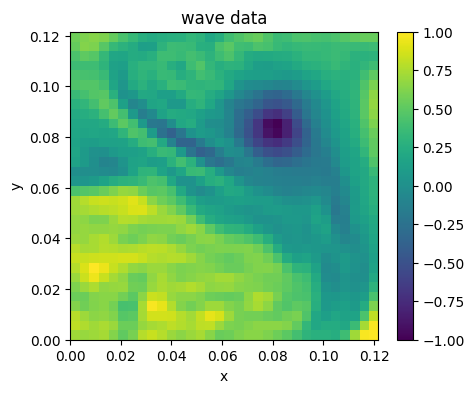

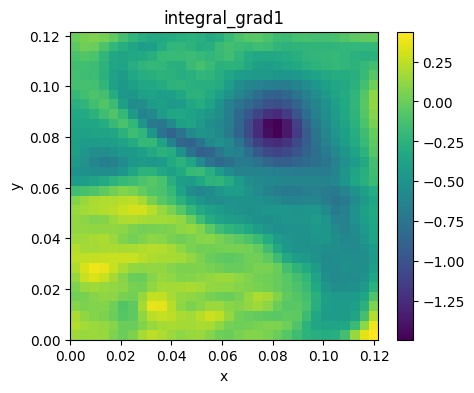

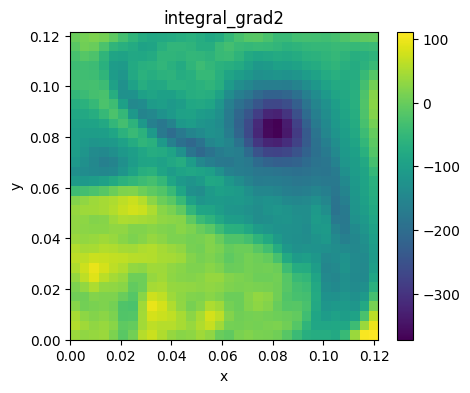

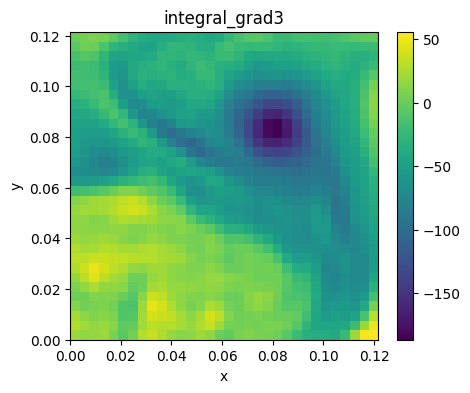

In [44]:
import numpy as np

# Функция для вычисления производных
def compute_gradients(data):
    dx = np.gradient(data, step_x, axis=0)  
    dy = np.gradient(data, step_y, axis=1)  
    return dx, dy

def integrate_gradients1(dx, dy, initial_value):
    
    integral_x = np.zeros_like(dx)
    integral_x[0] = initial_value  
    for i in range(1, dx.shape[0]):
        integral_x[i] = integral_x[i - 1] + (((dx[i] + dx[i - 1]) * step_x)) / 2  
    
    integral_y = np.zeros_like(dy)
    integral_y[:, 0] = integral_x[:, 0] 
    
    for j in range(1, dy.shape[1]):
        integral_y[:, j] = integral_y[:, j - 1] + (((dy[:, j] + dy[:, j - 1]) * step_y)) / 2  

    return integral_y

def integrate_gradients2(dx, dy, initial_value):
    
    integral_y= np.zeros_like(dx)
    integral_y[0] = initial_value  
    for i in range(1, dy.shape[0]):
        integral_y[:, i] = integral_y[:, i - 1] + ((dy[:, i] + dy[:, i - 1])) / 2  
    
    integral_x = np.zeros_like(dy)
    integral_x[0] = integral_y[0] 
    
    for j in range(1, dx.shape[1]):
        integral_x[j] = integral_x[j - 1] + ((dx[j] + dx[j - 1])) / 2  

    return integral_x


dx, dy = compute_gradients(data)
#dy = np.load('wave_Inverse_x_noise0.npy')
#dx = np.load('wave_Inverse_t_noise0.npy')

initial_value = 0.0
print(dy.shape[0])
print(dx.shape[1])

result1 = integrate_gradients1(dx, dy, initial_value)
result2 = integrate_gradients2(dx, dy, initial_value)

result3 = ((integrate_gradients1(dx, dy, initial_value) + integrate_gradients2(dx, dy, initial_value)) / 2)


print((np.square(data - result1)).mean(axis=None))
print((np.square(data - result2)).mean(axis=None))
print((np.square(data - result3)).mean(axis=None))

plt.figure(figsize=(5, 4))
plt.imshow(data, extent=[np.min(x),np.max(x),np.min(y),np.max(y)])
plt.title('wave data')
plt.xlabel('x')
plt.ylabel('y')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(result1, extent=[np.min(x),np.max(x),np.min(y),np.max(y)])
plt.title('integral_grad1')
plt.xlabel('x')
plt.ylabel('y')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(result2, extent=[np.min(x),np.max(x),np.min(y),np.max(y)])
plt.title('integral_grad2')
plt.xlabel('x')
plt.ylabel('y')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(result3, extent=[np.min(x),np.max(x),np.min(y),np.max(y)])
plt.title('integral_grad3')
plt.xlabel('x')
plt.ylabel('y')
plt.colorbar()
plt.show()
